Do not think I will end up using hydroBASINS to get polygons of watersheds. Looking into pysheds package.

In [1]:
import rioxarray as rxr
import xarray as xr
import numpy as np
import pandas as pd
import geopandas as gpd
import codebase
import matplotlib.pyplot as plt
import os
import re

In [2]:
datadir = '/global/scratch/users/ann_scheliga/aux_dam_datasets/HydroBASINS_NorAmer/'

In [3]:
os.listdir(datadir)

['hybas_na_lev08_v1c.sbn',
 'hybas_na_lev04_v1c.shp.xml',
 'hybas_na_lev03_v1c.shx',
 'hybas_na_lev02_v1c.shp.xml',
 'hybas_na_lev11_v1c.shp',
 'hybas_na_lev04_v1c.dbf',
 'hybas_na_lev02_v1c.shp',
 'hybas_na_lev12_v1c.shp.xml',
 'hybas_na_lev06_v1c.shx',
 'hybas_na_lev12_v1c.dbf',
 'hybas_na_lev11_v1c.sbx',
 'hybas_na_lev07_v1c.shp.xml',
 'hybas_na_lev10_v1c.shp',
 'HydroBASINS_TechDoc_v1c.pdf',
 'hybas_na_lev09_v1c.shp',
 'hybas_na_lev03_v1c.sbn',
 'hybas_na_lev12_v1c.prj',
 'hybas_na_lev11_v1c.shx',
 'hybas_na_lev03_v1c.dbf',
 'hybas_na_lev10_v1c.shx',
 'hybas_na_lev01_v1c.shp',
 'hybas_na_lev08_v1c.shx',
 'hybas_na_lev08_v1c.dbf',
 'hybas_na_lev10_v1c.dbf',
 'hybas_na_lev08_v1c.shp.xml',
 'hybas_na_lev01_v1c.shp.xml',
 'hybas_na_lev06_v1c.sbn',
 'hybas_na_lev02_v1c.sbn',
 'hybas_na_lev07_v1c.shx',
 'hybas_na_lev09_v1c.sbx',
 'hybas_na_lev06_v1c.dbf',
 'hybas_na_lev05_v1c.prj',
 'hybas_na_lev07_v1c.dbf',
 'hybas_na_lev01_v1c.dbf',
 'hybas_na_lev02_v1c.prj',
 'hybas_na_lev05_v1c.shx',

In [4]:
lvls = {}

In [5]:
for lvl in np.arange(1,7):
    lvls[lvl] = gpd.read_file(datadir + 'hybas_na_lev'+str(f'{lvl:02}')+'_v1c.shp')

In [6]:
lvls[5].head()

,HYBAS_ID,NEXT_DOWN,NEXT_SINK,MAIN_BAS,DIST_SINK,DIST_MAIN,SUB_AREA,UP_AREA,PFAF_ID,ENDO,COAST,ORDER,SORT,geometry
0,7050000010,0,7050000010,7050000010,0.0,0.0,71428.4,71428.4,77111,0,1,0,1,"MULTIPOLYGON (((-81.05972 7.70000, -81.06310 7..."
1,7050002400,0,7050002400,7050002400,0.0,0.0,8088.1,8088.1,77112,0,0,1,2,"POLYGON ((-86.71250 14.12083, -86.70918 14.119..."
2,7050002410,0,7050002410,7050002410,0.0,0.0,10635.7,10635.7,77113,0,1,0,3,"MULTIPOLYGON (((-87.70972 13.32083, -87.72422 ..."
3,7050002700,0,7050002700,7050002700,0.0,0.0,18283.0,18283.0,77114,0,0,1,4,"POLYGON ((-88.48750 14.34167, -88.48693 14.343..."
4,7050002710,0,7050002710,7050002710,0.0,0.0,44940.5,44940.5,77115,0,1,0,5,"MULTIPOLYGON (((-94.36389 16.20417, -94.36992 ..."


In [7]:
{print(lvls[lvl].shape) for lvl in lvls}

(1, 14)
(8, 14)
(29, 14)
(185, 14)
(624, 14)
(2043, 14)


{None}

In [8]:
lvls[4].explore('PFAF_ID')

### Notes and IDs
Colorado River Basin = 772

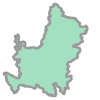

In [9]:
PFAF_ID = 772
subset_row = (lvls[3]["PFAF_ID"]) == (PFAF_ID)
lvls[3][subset_row].unary_union
# subset_gpd["geometry"].buffer(buffer_val).unary_union

In [10]:
subset_rows = lvls[4]["PFAF_ID"].astype(str).str.startswith('772')

lvls[4][subset_rows]

,HYBAS_ID,NEXT_DOWN,NEXT_SINK,MAIN_BAS,DIST_SINK,DIST_MAIN,SUB_AREA,UP_AREA,PFAF_ID,ENDO,COAST,ORDER,SORT,geometry
9,7040008710,0,7040008710,7040008710,0.0,0.0,5056.9,620437.5,7721,0,0,1,10,"POLYGON ((-114.95833 32.29167, -114.94258 32.2..."
10,7040707810,7040008710,7040008710,7040008710,184.0,184.0,155895.6,155895.6,7722,0,0,2,11,"POLYGON ((-111.32917 34.42917, -111.32827 34.4..."
11,7040707710,7040008710,7040008710,7040008710,184.2,184.2,117076.9,466505.3,7723,0,0,1,12,"POLYGON ((-114.82917 35.59167, -114.82952 35.5..."
12,7040632220,7040707710,7040008710,7040008710,1140.0,1140.0,69703.6,69703.6,7724,0,0,2,13,"POLYGON ((-108.23750 34.42917, -108.20591 34.4..."
13,7040632150,7040707710,7040008710,7040008710,1140.1,1140.1,14353.6,285991.7,7725,0,0,1,14,"POLYGON ((-111.29167 36.52500, -111.30000 36.5..."
14,7040608130,7040632150,7040008710,7040008710,1334.3,1334.3,64724.6,64725.4,7726,0,0,2,15,"POLYGON ((-108.58333 35.70000, -108.58422 35.6..."
15,7040607990,7040632150,7040008710,7040008710,1334.5,1334.5,23992.7,207533.3,7727,0,0,1,16,"POLYGON ((-111.51250 39.05833, -111.51184 39.0..."
16,7040585120,7040607990,7040008710,7040008710,1542.6,1542.6,67936.1,67936.5,7728,0,0,2,17,"POLYGON ((-105.93750 40.36667, -105.93785 40.3..."
17,7040585110,7040607990,7040008710,7040008710,1542.7,1542.7,115603.9,115603.9,7729,0,0,1,18,"POLYGON ((-109.86667 38.39167, -109.86631 38.3..."
178,7040073710,7040008710,7040073710,7040008710,0.0,1.0,26767.9,26767.9,7720,2,0,2,179,"POLYGON ((-116.55417 33.32083, -116.55473 33.3..."


## Trying out subsetting by hydroBASINS

In [2]:
hydroBASINS_na3 = codebase.load_data.load_hydroBASINS(continent = 'na', lvl = 3)
CBR_gpd = codebase.area_subsets.hydroBASINS_by_PFAFID(772,hydroBASINS_na3)

In [8]:
temp_era5 = xr.open_dataarray('../scripts/2019_daily_tempK.nc')

In [12]:
test_subset = codebase.area_subsets.xr_shape_subset(subset_gpd = CBR_gpd, input_xr = temp_era5)

Grabbed lat/lon dims. Consider reprojecting!


In [16]:
test_subset

<xarray.DataArray 't2m' (valid_time: 365, latitude: 36, longitude: 45)>
array([[[      nan,       nan,       nan, ..., 255.90514, 254.036  ,
         252.60484],
        [      nan,       nan,       nan, ..., 256.13025, 253.67613,
               nan],
        [      nan,       nan,       nan, ..., 254.89879, 252.93346,
               nan],
        ...,
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan],
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan],
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan]],

       [[      nan,       nan,       nan, ..., 256.5463 , 255.20645,
         255.14737],
        [      nan,       nan,       nan, ..., 255.24844, 254.99942,
               nan],
        [      nan,       nan,       nan, ..., 255.17911, 254.33438,
               nan],
...
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan],
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan],
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan]],

       [[      nan,       nan,       nan, ..., 257.6753 , 256.6836 ,
         257.31934],
        [      nan,       nan,       nan, ..., 256.66357, 256.78613,
               nan],
        [      nan,       nan,       nan, ..., 255.79344, 256.07715,
               nan],
        ...,
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan],
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan],
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan]]], dtype=float32)
Coordinates:
    number       int64 ...
  * latitude     (latitude) float64 40.0 39.75 39.5 39.25 ... 31.75 31.5 31.25
  * longitude    (longitude) float64 -116.8 -116.5 -116.2 ... -106.0 -105.8
  * valid_time   (valid_time) datetime64[ns] 2019-01-01 ... 2019-12-31
    spatial_ref  int64 0
Attributes: (12/32)
    GRIB_paramId:                             167
    GRIB_dataType:                            an
    GRIB_numberOfPoints:                      462240
    GRIB_typeOfLevel:                         surface
    GRIB_stepUnits:                           1
    GRIB_stepType:                            instant
    ...                                       ...
    GRIB_totalNumber:                         0
    GRIB_units:                               K
    long_name:                                2 metre temperature
    units:                                    K
    standard_name:                            unknown
    GRIB_surface:                             0.0

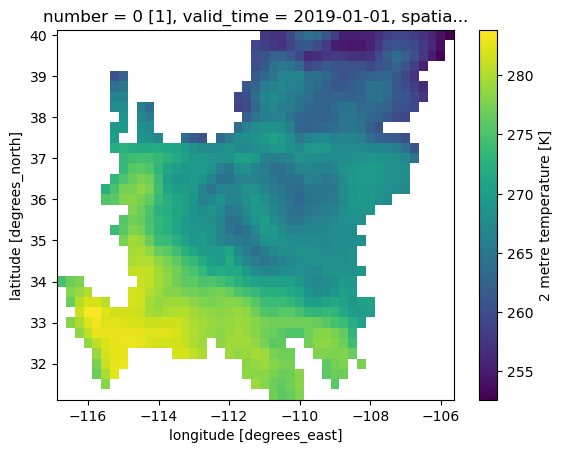

In [15]:
test_subset.isel(valid_time=0).plot()

In [ ]:
## Goal: grab all instances of a variable. Join xrs along assigned dimension.

In [3]:
metdatadir = '/global/scratch/users/ann_scheliga/era5_test_data/'
input_regex = r'daily_tempK'

In [4]:
metdata_allfiles = os.listdir(metdatadir)

In [5]:
files_OI = [filename for filename in metdata_allfiles if input_regex in filename]
files_OI.sort()
files_OI

['2019daily_tempK.nc',
 '2020daily_tempK.nc',
 '2021daily_tempK.nc',
 '2022daily_tempK.nc',
 '2023daily_tempK.nc']

In [6]:
def quick_subset(filename_xr):
    full_DA = xr.open_dataarray(filename_xr)
    subset_DA = codebase.area_subsets.xr_shape_subset(subset_gpd = CBR_gpd, input_xr = full_DA)
    return subset_DA

In [7]:
def subset_concat_from_filenames(ordered_filenames, filepath, xr_concat_dict= {}):
    items_to_concat = [None] * len(ordered_filenames)
    for idx, filename in enumerate(ordered_filenames):
        items_to_concat[idx] = quick_subset(filepath+filename)
    concat_DA = xr.concat(items_to_concat, **xr_concat_dict)
    return concat_DA

In [8]:
concat_dict = {'dim':'valid_time'}
test_concat = subset_concat_from_filenames(files_OI, metdatadir,concat_dict)

Grabbed lat/lon dims. Consider reprojecting!
Grabbed lat/lon dims. Consider reprojecting!
Grabbed lat/lon dims. Consider reprojecting!
Grabbed lat/lon dims. Consider reprojecting!
Grabbed lat/lon dims. Consider reprojecting!


In [89]:
subset0 = quick_subset(metdatadir + files_OI[0])
subset1 = quick_subset(metdatadir + files_OI[1])

Grabbed lat/lon dims. Consider reprojecting!
Grabbed lat/lon dims. Consider reprojecting!


In [90]:
xr.concat([subset0, subset1], dim = 'valid_time')

<xarray.DataArray 't2m' (valid_time: 730, latitude: 36, longitude: 45)>
array([[[      nan,       nan,       nan, ..., 271.81903, 270.73065,
         270.6125 ],
        [      nan,       nan,       nan, ..., 270.20477, 268.6999 ,
               nan],
        [      nan,       nan,       nan, ..., 269.47577, 268.51825,
               nan],
        ...,
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan],
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan],
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan]],

       [[      nan,       nan,       nan, ..., 272.00842, 270.13977,
         268.64807],
        [      nan,       nan,       nan, ..., 270.90393, 269.5631 ,
               nan],
        [      nan,       nan,       nan, ..., 268.9674 , 268.5006 ,
               nan],
...
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan],
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan],
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan]],

       [[      nan,       nan,       nan, ..., 267.13428, 267.10254,
         267.69922],
        [      nan,       nan,       nan, ..., 266.8125 , 265.89795,
               nan],
        [      nan,       nan,       nan, ..., 264.82324, 264.07422,
               nan],
        ...,
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan],
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan],
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan]]], dtype=float32)
Coordinates:
    number       int64 0
  * latitude     (latitude) float64 40.0 39.75 39.5 39.25 ... 31.75 31.5 31.25
  * longitude    (longitude) float64 -116.8 -116.5 -116.2 ... -106.0 -105.8
  * valid_time   (valid_time) datetime64[ns] 2023-01-01 ... 2021-12-31
    spatial_ref  int64 0
Attributes: (12/32)
    GRIB_paramId:                             167
    GRIB_dataType:                            an
    GRIB_numberOfPoints:                      462240
    GRIB_typeOfLevel:                         surface
    GRIB_stepUnits:                           1
    GRIB_stepType:                            instant
    ...                                       ...
    GRIB_totalNumber:                         0
    GRIB_units:                               K
    long_name:                                2 metre temperature
    units:                                    K
    standard_name:                            unknown
    GRIB_surface:                             0.0

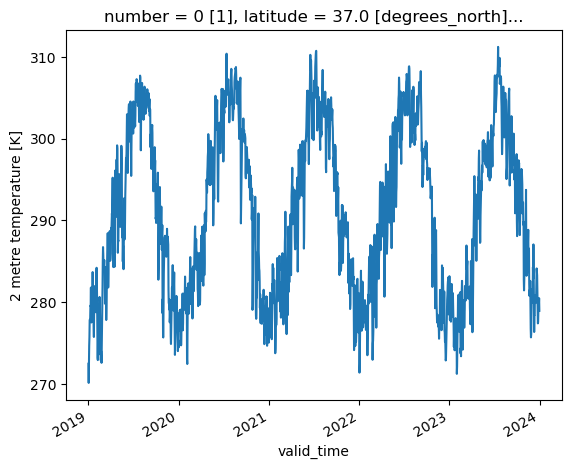

In [104]:
test_concat.isel(latitude = 12, longitude = 12).plot()

In [ ]:
## Trying out functions

In [10]:
codebase.area_subsets.era5_shape_subset_and_concat(CBR_gpd,files_OI,metdatadir,concat_dict= {'dim':'valid_time'})

Grabbed lat/lon dims. Consider reprojecting!
Grabbed lat/lon dims. Consider reprojecting!
Grabbed lat/lon dims. Consider reprojecting!
Grabbed lat/lon dims. Consider reprojecting!
Grabbed lat/lon dims. Consider reprojecting!


<xarray.DataArray 't2m' (valid_time: 1826, latitude: 36, longitude: 45)>
array([[[      nan,       nan,       nan, ..., 255.90514, 254.036  ,
         252.60484],
        [      nan,       nan,       nan, ..., 256.13025, 253.67613,
               nan],
        [      nan,       nan,       nan, ..., 254.89879, 252.93346,
               nan],
        ...,
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan],
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan],
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan]],

       [[      nan,       nan,       nan, ..., 256.5463 , 255.20645,
         255.14737],
        [      nan,       nan,       nan, ..., 255.24844, 254.99942,
               nan],
        [      nan,       nan,       nan, ..., 255.17911, 254.33438,
               nan],
...
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan],
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan],
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan]],

       [[      nan,       nan,       nan, ..., 262.9359 , 262.3778 ,
         262.8817 ],
        [      nan,       nan,       nan, ..., 264.69617, 264.0326 ,
               nan],
        [      nan,       nan,       nan, ..., 265.40955, 264.15955,
               nan],
        ...,
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan],
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan],
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan]]], dtype=float32)
Coordinates:
    number       int64 0
  * latitude     (latitude) float64 40.0 39.75 39.5 39.25 ... 31.75 31.5 31.25
  * longitude    (longitude) float64 -116.8 -116.5 -116.2 ... -106.0 -105.8
  * valid_time   (valid_time) datetime64[ns] 2019-01-01 ... 2023-12-31
    spatial_ref  int64 0
Attributes: (12/32)
    GRIB_paramId:                             167
    GRIB_dataType:                            an
    GRIB_numberOfPoints:                      462240
    GRIB_typeOfLevel:                         surface
    GRIB_stepUnits:                           1
    GRIB_stepType:                            instant
    ...                                       ...
    GRIB_totalNumber:                         0
    GRIB_units:                               K
    long_name:                                2 metre temperature
    units:                                    K
    standard_name:                            unknown
    GRIB_surface:                             0.0

In [105]:
type(temp_era5)

xarray.core.dataarray.DataArray

In [102]:
test_concat

<xarray.DataArray 't2m' (valid_time: 1826, latitude: 36, longitude: 45)>
array([[[      nan,       nan,       nan, ..., 255.90514, 254.036  ,
         252.60484],
        [      nan,       nan,       nan, ..., 256.13025, 253.67613,
               nan],
        [      nan,       nan,       nan, ..., 254.89879, 252.93346,
               nan],
        ...,
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan],
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan],
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan]],

       [[      nan,       nan,       nan, ..., 256.5463 , 255.20645,
         255.14737],
        [      nan,       nan,       nan, ..., 255.24844, 254.99942,
               nan],
        [      nan,       nan,       nan, ..., 255.17911, 254.33438,
               nan],
...
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan],
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan],
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan]],

       [[      nan,       nan,       nan, ..., 262.9359 , 262.3778 ,
         262.8817 ],
        [      nan,       nan,       nan, ..., 264.69617, 264.0326 ,
               nan],
        [      nan,       nan,       nan, ..., 265.40955, 264.15955,
               nan],
        ...,
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan],
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan],
        [      nan,       nan,       nan, ...,       nan,       nan,
               nan]]], dtype=float32)
Coordinates:
    number       int64 0
  * latitude     (latitude) float64 40.0 39.75 39.5 39.25 ... 31.75 31.5 31.25
  * longitude    (longitude) float64 -116.8 -116.5 -116.2 ... -106.0 -105.8
  * valid_time   (valid_time) datetime64[ns] 2019-01-01 ... 2023-12-31
    spatial_ref  int64 0
Attributes: (12/32)
    GRIB_paramId:                             167
    GRIB_dataType:                            an
    GRIB_numberOfPoints:                      462240
    GRIB_typeOfLevel:                         surface
    GRIB_stepUnits:                           1
    GRIB_stepType:                            instant
    ...                                       ...
    GRIB_totalNumber:                         0
    GRIB_units:                               K
    long_name:                                2 metre temperature
    units:                                    K
    standard_name:                            unknown
    GRIB_surface:                             0.0